## Four ring PSO

In [9]:
import numpy as np
from scipy.optimize import minimize, Bounds
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import four_rings
import magpylib as magpy
from magpylib.magnet import CylinderSegment
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def nonuniformity(x):
    f = []
    for i in range(len(x)):
        innerrad1, innerrad2, width, dist1, dist2 = x[i]
        thickness = 2
        magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
        grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
        f.append(av_nonuniformity)
    return f

options = {'c1': 0.4, 'c2': 0.3, 'w':0.9}
oh_strategy = {"w":'exp_decay', 'c1':'nonlin_mod', 'c2':'lin_variation'}

bounds = ([10, 10, 2, 1, 1], [150, 150, 10, 250, 270])

# Call instance of PSO
optimizer = ps.single.GlobalBestPSO(n_particles=20, dimensions=5, options=options, oh_strategy=oh_strategy, bounds=bounds)

# Perform optimization
cost, pos = optimizer.optimize(nonuniformity, iters=100)

2023-06-29 15:50:02,090 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.4, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|███████████████████|100/100, best_cost=2.77e-6
2023-06-29 15:51:08,877 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 2.773353352543778e-06, best pos: [116.6932322   72.9318123    8.41002986 170.74894568 223.16490945]


On x-axis:
Maximum B-field: 4.219 G
Central B-field: 4.219 G
Min nonuniformity: 0.0
Max nonuniformity:2.75854790130502e-06


On y-axis:
Maximum B-field: 4.219 G
Central B-field: 4.219 G
Min nonuniformity: 0.0
Max nonuniformity:2.75854790130502e-06


On z-axis:
Maximum B-field: 4.219 G
Central B-field: 4.219 G
Min nonuniformity: 0.0
Max nonuniformity:5.711007428614137e-05




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


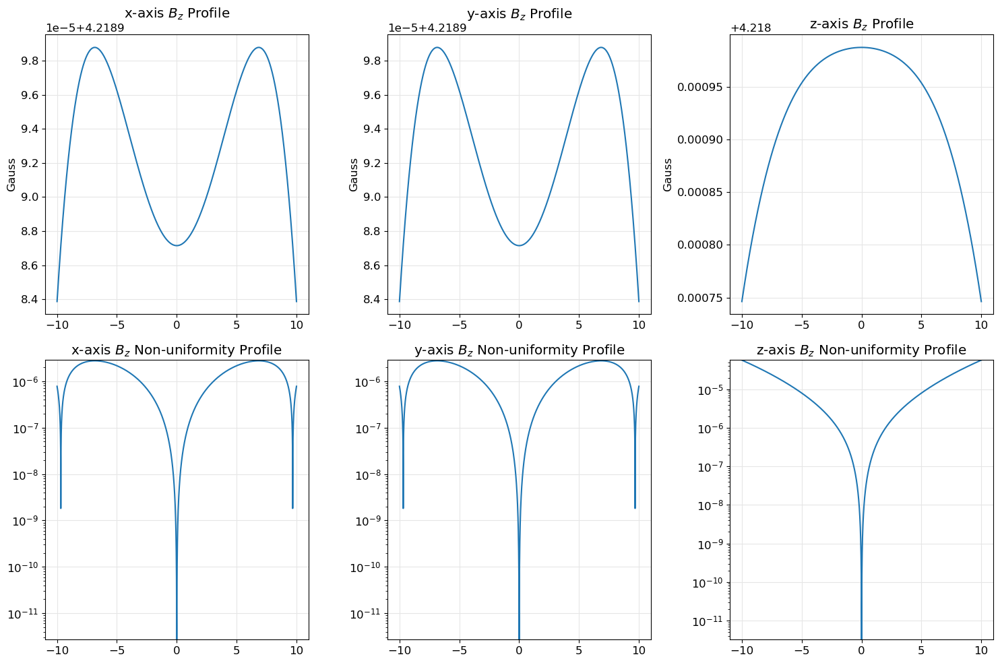

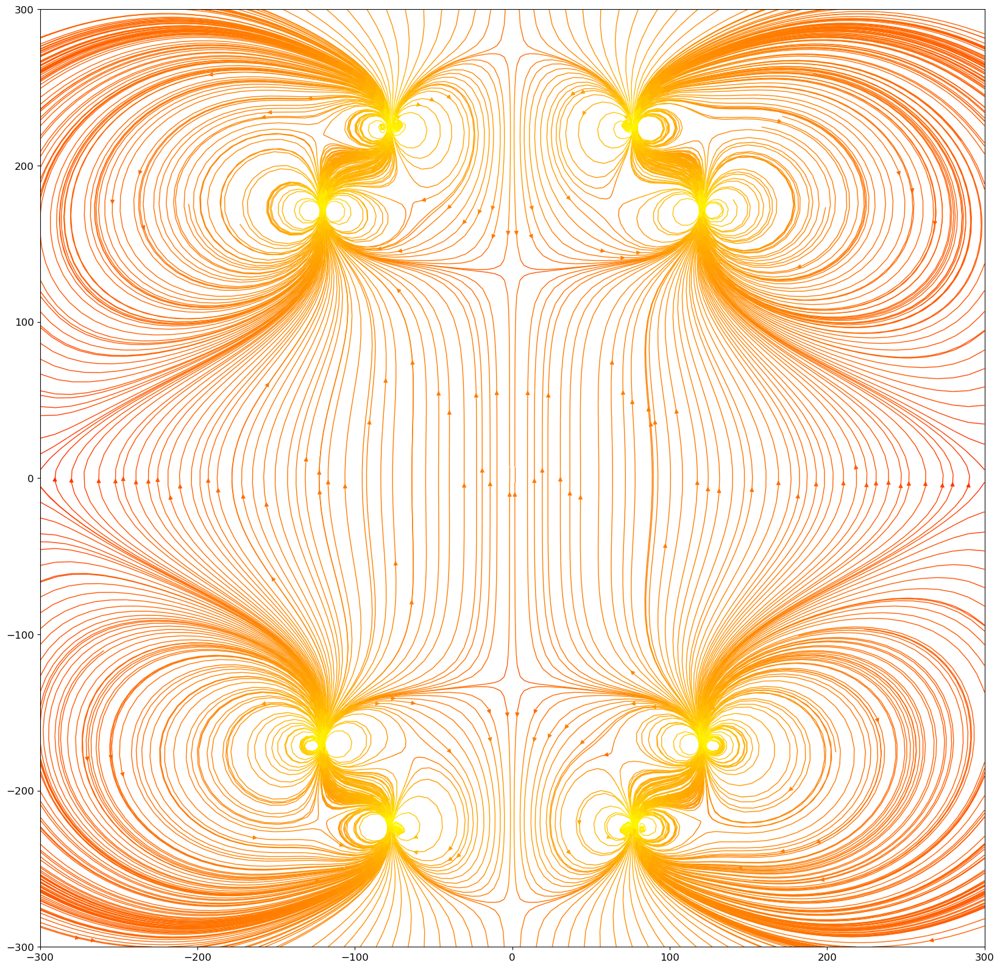

In [10]:
from maggeometry import four_rings
import magpylib as magpy
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
Br = 1.09e3
# x = [ 1.465e+02,  1.732e+01,  1.000e+01,  9.057e+00,  2.115e+02, 2.438e+02]
thickness = 2
innerrad1, innerrad2, width, dist1, dist2 = pos
# innerrad1, innerrad2, width, thickness, dist1, dist2 = x
magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-300, 300]
z_bounds = [-300, 300]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [11]:
import numpy as np
from scipy.optimize import minimize, Bounds
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import four_rings
import magpylib as magpy
from magpylib.magnet import CylinderSegment
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def nonuniformity(x):
    f = []
    for i in range(len(x)):
        innerrad1, innerrad2, width, dist1, dist2 = x[i]
        thickness = 2
        magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
        grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
        f.append(av_nonuniformity)
    return f

options = {'c1': 0.4, 'c2': 0.3, 'w':0.9}
oh_strategy = {"w":'exp_decay', 'c1':'nonlin_mod', 'c2':'lin_variation'}

bounds = ([10, 10, 2, 1, 1], [150, 150, 10, 150, 150])

# Call instance of PSO
optimizer = ps.single.GlobalBestPSO(n_particles=20, dimensions=5, options=options, oh_strategy=oh_strategy, bounds=bounds)

# Perform optimization
cost, pos = optimizer.optimize(nonuniformity, iters=100)

2023-06-29 15:52:44,146 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.4, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|███████████████████|100/100, best_cost=8.65e-7
2023-06-29 15:53:52,935 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 8.645979405751302e-07, best pos: [ 99.55805085  34.55408317   7.06685835 113.94463905 136.68456399]


On x-axis:
Maximum B-field: 6.503 G
Central B-field: 6.503 G
Min nonuniformity: 0.0
Max nonuniformity:1.2376806283008302e-05


On y-axis:
Maximum B-field: 6.503 G
Central B-field: 6.503 G
Min nonuniformity: 0.0
Max nonuniformity:1.2376806283008302e-05


On z-axis:
Maximum B-field: 6.503 G
Central B-field: 6.503 G
Min nonuniformity: 0.0
Max nonuniformity:5.373527822604523e-05


Uniform region width with threshold 1e-06: x = 2.153 cm, y = 2.153 cm, z = 0.704 cm


/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:163: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:168: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:173: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


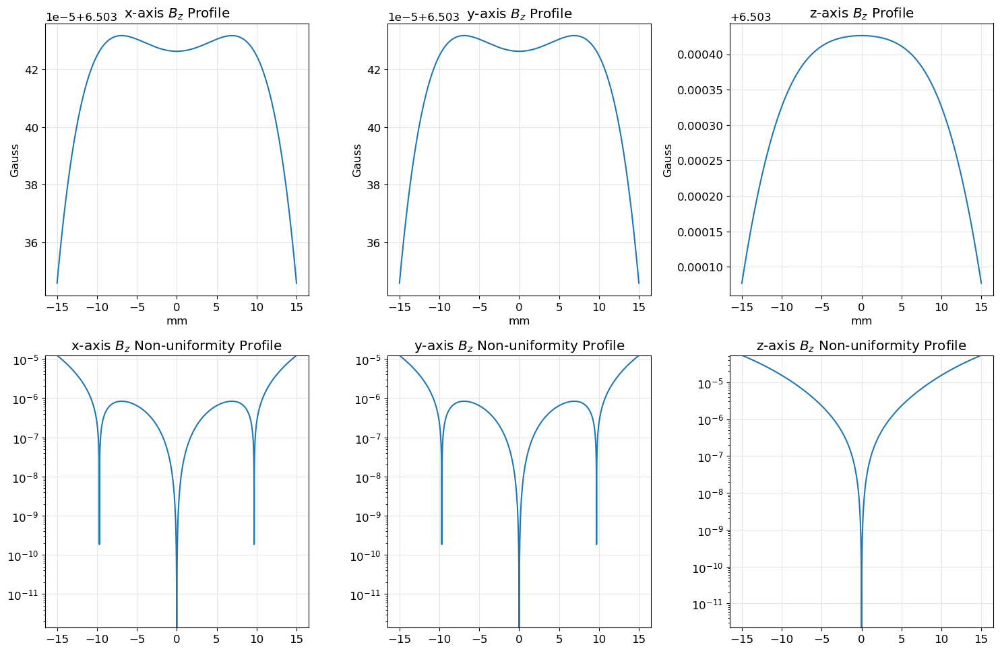

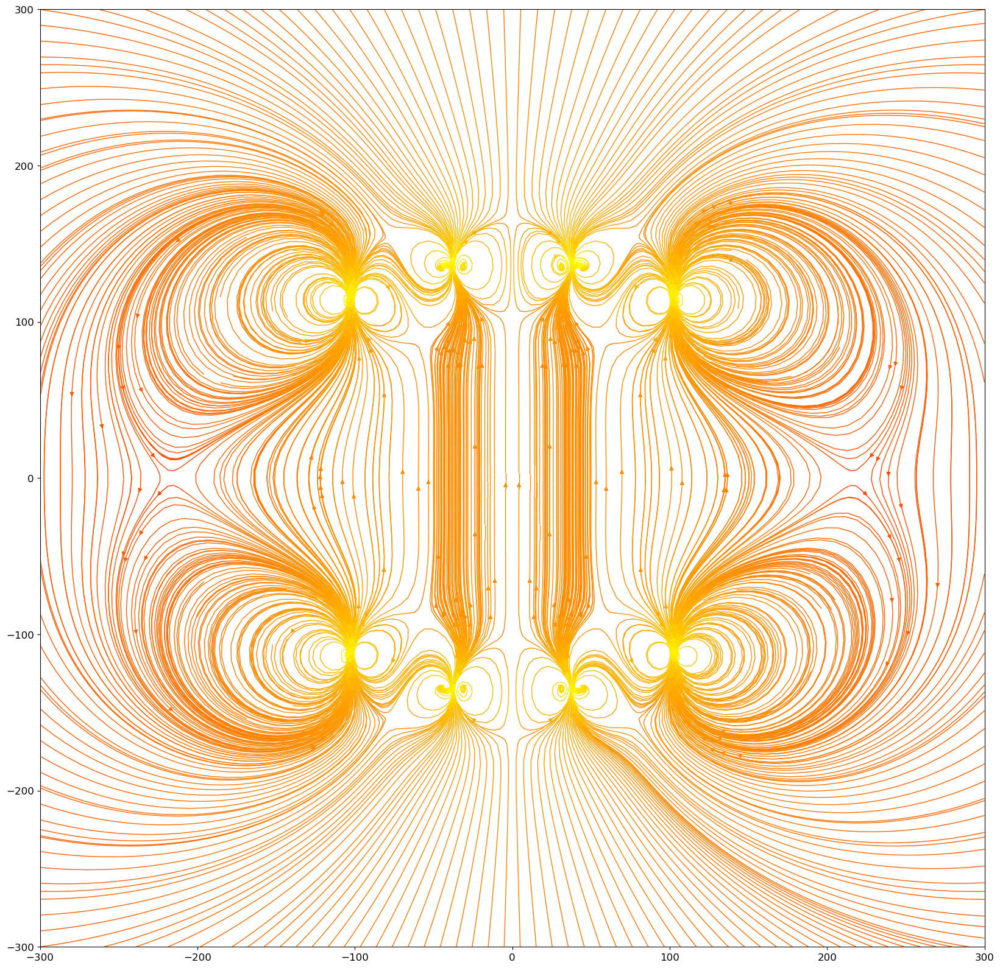

In [1]:
from maggeometry import four_rings
import magpylib as magpy
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
Br = 1.09e3
pos = [ 99.55805085, 34.55408317, 7.06685835, 113.94463905, 136.68456399]
thickness = 2
innerrad1, innerrad2, width, dist1, dist2 = pos
magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
sens_len = 15
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-300, 300]
z_bounds = [-300, 300]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [4]:
import numpy as np
u_v = np.pi * 2.153**2 * 0.704
print(f"Uniform volume: {round(u_v, 3)} cm^3")

# Remember to convert to cm^3 with the factor of 1000
s_v = np.pi * innerrad1**2 * (2*dist2) / 1000
print(f"Structure enclosed volume: {round(s_v, 3)} cm^3")

r = u_v/s_v * 100

print(f"Uniform proportion: {round(r, 5)}%")

Uniform volume: 10.252 cm^3
Structure enclosed volume: 8512.402 cm^3
Uniform proportion: 0.12044%


Nelder-Mead optimization for four rings #1

In [2]:
from maggeometry import four_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
# innerrad1, innerrad2, width, thickness, dist1, dist2
# x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

bounds = Bounds([10, 10, 2, 2, 1, 1], [150, 150, 10, 20, 250, 270])
x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000003
         Iterations: 668
         Function evaluations: 1076
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 2.5521622182234797e-06
             x: [ 1.465e+02  1.732e+01  1.000e+01  9.057e+00  2.115e+02
                  2.438e+02]
           nit: 668
          nfev: 1076
 final_simplex: (array([[ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02],
                       [ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02],
                       ...,
                       [ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02],
                       [ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02]]), array([ 2.552e-06,  2.552e-06,  2.552e-06,  2.552e-06,
                        2.552e-06,  2.552e-06,  2.552e-06]))


In [5]:
print(res.x)

[146.49364671  17.31971572  10.           9.05666757 211.54421802
 243.80349358]


On x-axis:
Maximum B-field: 11.306 G
Central B-field: 11.306 G
Min nonuniformity: 0.0
Max nonuniformity:2.5521625737679895e-06


On y-axis:
Maximum B-field: 11.306 G
Central B-field: 11.306 G
Min nonuniformity: 0.0
Max nonuniformity:2.5521625737679895e-06


On z-axis:
Maximum B-field: 11.306 G
Central B-field: 11.306 G
Min nonuniformity: 0.0
Max nonuniformity:2.2161070122887647e-05




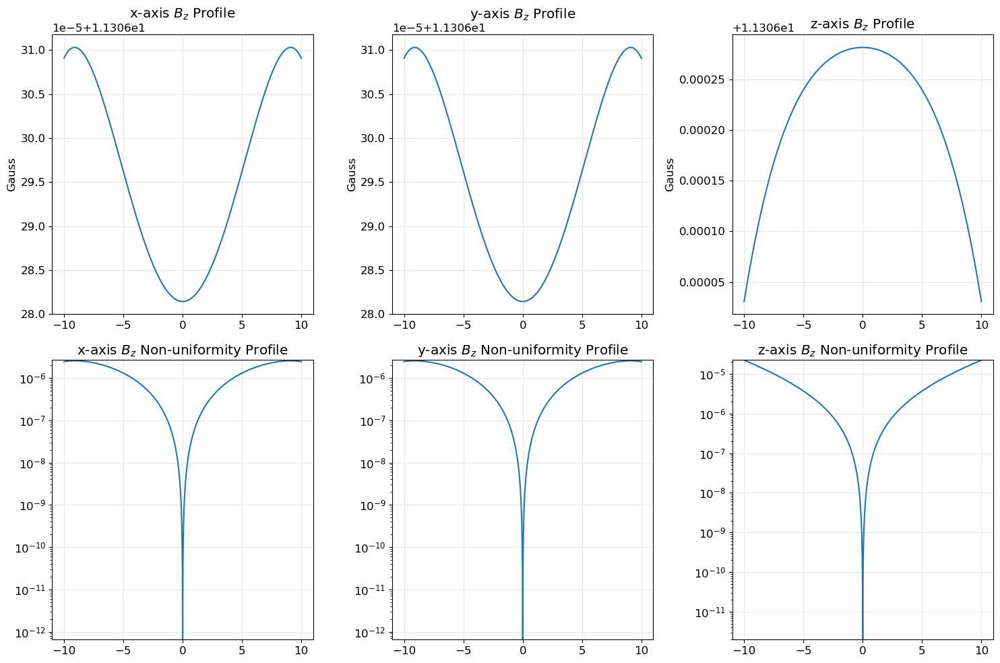

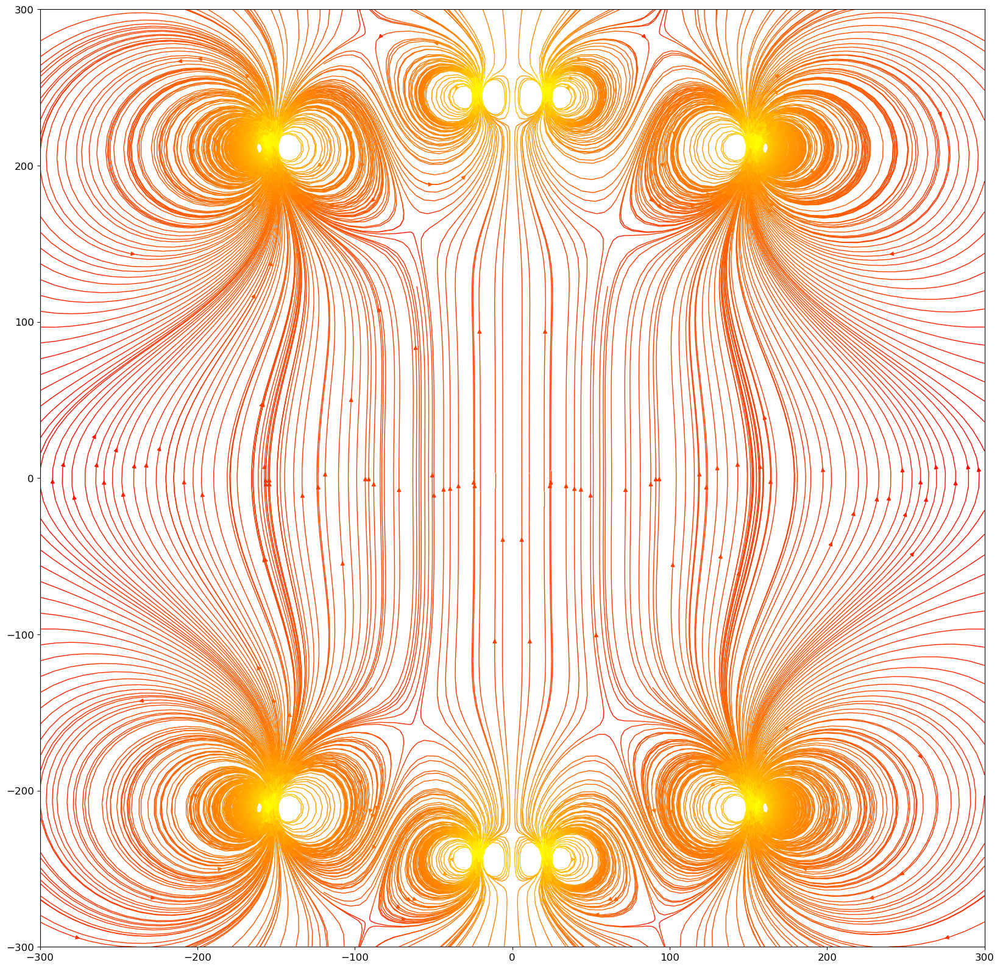

In [7]:
from maggeometry import four_rings
import magpylib as magpy
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
Br = 1.09e3
# x = [ 1.465e+02,  1.732e+01,  1.000e+01,  9.057e+00,  2.115e+02, 2.438e+02]
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
# innerrad1, innerrad2, width, thickness, dist1, dist2 = x
magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
x_bounds = [-300, 300]
z_bounds = [-300, 300]
make_flux_stream(magnets, x_bounds, z_bounds, [])

Nelder-Mead optimization for four rings geometry #2

In [16]:
from maggeometry import four_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
# innerrad1, innerrad2, width, thickness, dist1, dist2
# x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

# innerrad1, innerrad2, width, thickness, dist1, dist2
bounds = Bounds([1, 1, 2, 2, 1, 1], [150, 150, 10, 20, 300, 300])
x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000003
         Iterations: 690
         Function evaluations: 1103
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 3.4424184372122933e-06
             x: [ 1.444e+02  4.012e+01  8.356e+00  2.000e+01  2.173e+02
                  2.918e+02]
           nit: 690
          nfev: 1103
 final_simplex: (array([[ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02],
                       [ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02],
                       ...,
                       [ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02],
                       [ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02]]), array([ 3.442e-06,  3.442e-06,  3.442e-06,  3.442e-06,
                        3.442e-06,  3.442e-06,  3.442e-06]))


On x-axis:
Maximum B-field: 21.56 G
Central B-field: 21.56 G
Min nonuniformity: 0.0
Max nonuniformity:3.4424194413895665e-06


On y-axis:
Maximum B-field: 21.56 G
Central B-field: 21.56 G
Min nonuniformity: 0.0
Max nonuniformity:3.4424194413895665e-06


On z-axis:
Maximum B-field: 21.56 G
Central B-field: 21.56 G
Min nonuniformity: 0.0
Max nonuniformity:3.0036646643077485e-05




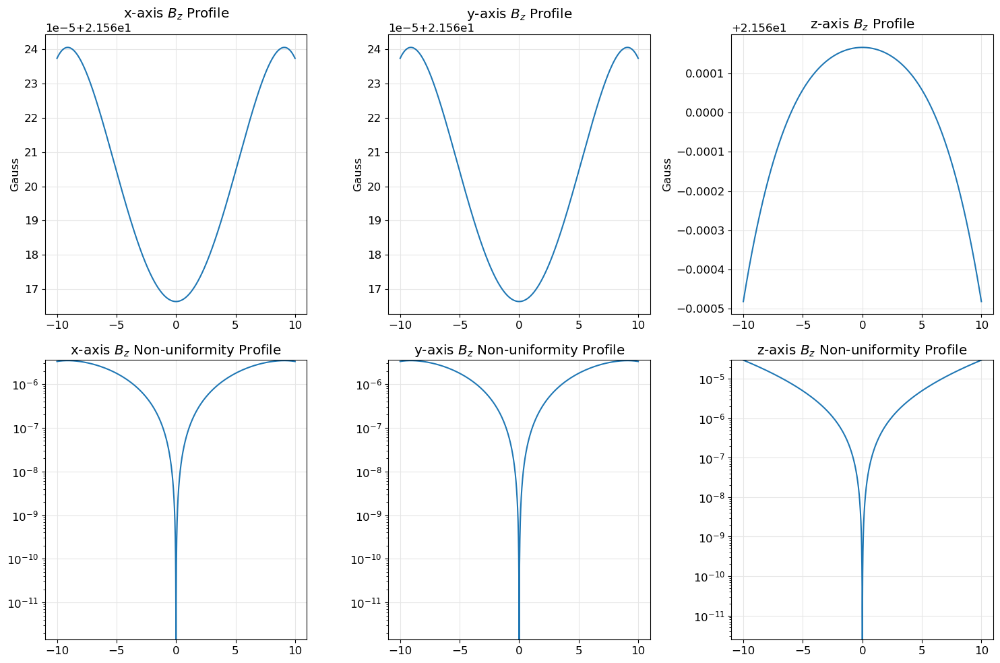

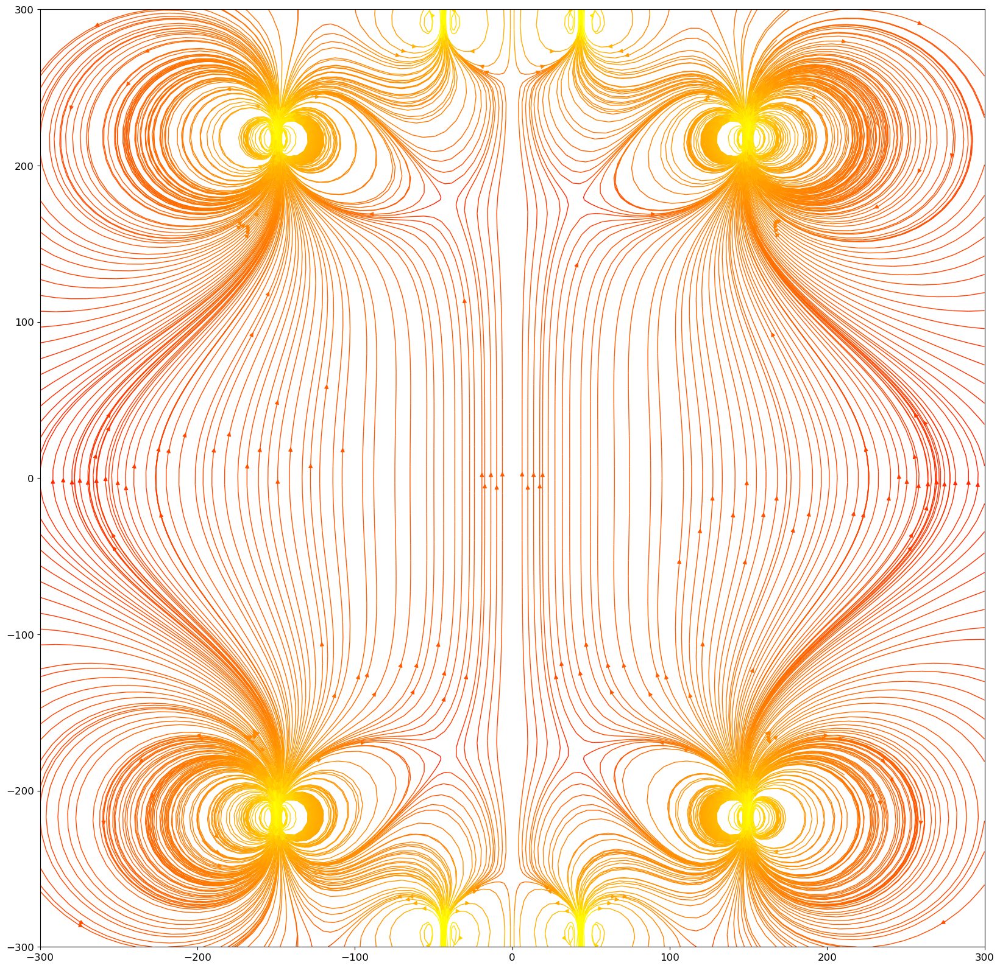

In [17]:
from maggeometry import four_rings
import magpylib as magpy
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
Br = 1.09e3

innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

make_flux_stream(magnets, x_bounds, z_bounds, [])

Powell optimization geometry 1

In [7]:
from maggeometry import four_rings
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
# innerrad1, innerrad2, width, thickness, dist1, dist2
# x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

# innerrad1, innerrad2, width, thickness, dist1, dist2
bounds = Bounds([1, 1, 2, 2, 1, 1], [150, 150, 10, 20, 300, 300])
x0 = [133.416, 130, 5, 2.4, 200, 250]
options = {'disp':True}
method = "Powell"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000006
         Iterations: 2
         Function evaluations: 328
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 6.242177510428639e-06
       x: [ 1.215e+02  1.300e+02  5.000e+00  2.401e+00  2.000e+02
            2.500e+02]
     nit: 2
   direc: [[ 1.000e+00  0.000e+00 ...  0.000e+00  0.000e+00]
           [ 0.000e+00  1.000e+00 ...  0.000e+00  0.000e+00]
           ...
           [ 0.000e+00  0.000e+00 ...  1.000e+00  0.000e+00]
           [ 0.000e+00  0.000e+00 ...  0.000e+00  1.000e+00]]
    nfev: 328


On x-axis:
Maximum B-field: 2.479 G
Central B-field: 2.479 G
Min nonuniformity: 0.0
Max nonuniformity:6.242177641181446e-06


On y-axis:
Maximum B-field: 2.479 G
Central B-field: 2.479 G
Min nonuniformity: 0.0
Max nonuniformity:6.242177641181446e-06


On z-axis:
Maximum B-field: 2.479 G
Central B-field: 2.479 G
Min nonuniformity: 0.0
Max nonuniformity:5.4648977362732104e-05




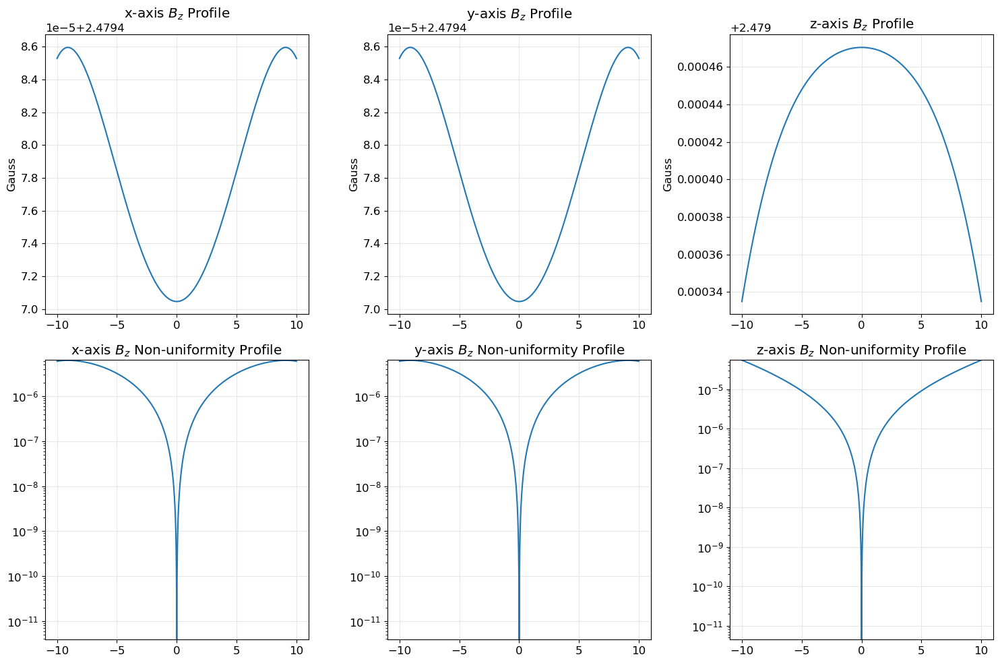

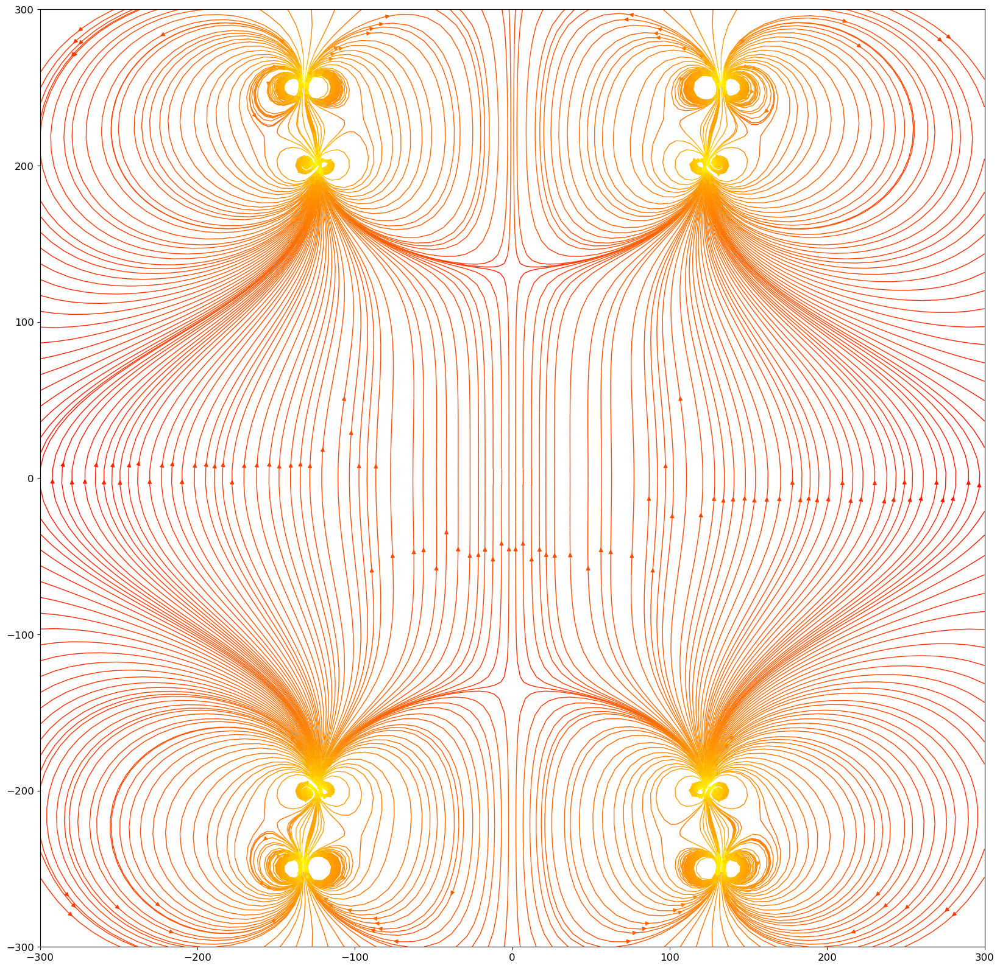

In [9]:
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

x_bounds = [-300, 300]
z_bounds = [-300, 300]
outerrad1 = innerrad1 + width
make_flux_stream(magnets, x_bounds, z_bounds, [])

Powell optimization geometry 2

In [10]:
bounds = Bounds([1, 1, 2, 2, 1, 1], [150, 150, 10, 20, 300, 300])
x0 = [30, 30, 5, 2.4, 50, 100]
options = {'disp':True}
method = "Powell"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000094
         Iterations: 3
         Function evaluations: 482
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 9.400089839185525e-05
       x: [ 9.485e+01  3.000e+01  6.476e+00  2.400e+00  7.674e+01
            1.000e+02]
     nit: 3
   direc: [[ 1.000e+00  0.000e+00 ...  0.000e+00  0.000e+00]
           [ 0.000e+00  1.000e+00 ...  0.000e+00  0.000e+00]
           ...
           [ 0.000e+00  0.000e+00 ...  1.000e+00  0.000e+00]
           [ 0.000e+00  0.000e+00 ...  0.000e+00  1.000e+00]]
    nfev: 482


On x-axis:
Maximum B-field: 9.372 G
Central B-field: 9.372 G
Min nonuniformity: 0.0
Max nonuniformity:9.399346308179222e-05


On y-axis:
Maximum B-field: 9.372 G
Central B-field: 9.372 G
Min nonuniformity: 0.0
Max nonuniformity:9.399346308179222e-05


On z-axis:
Maximum B-field: 9.38 G
Central B-field: 9.372 G
Min nonuniformity: 0.0
Max nonuniformity:0.0008208954103779842




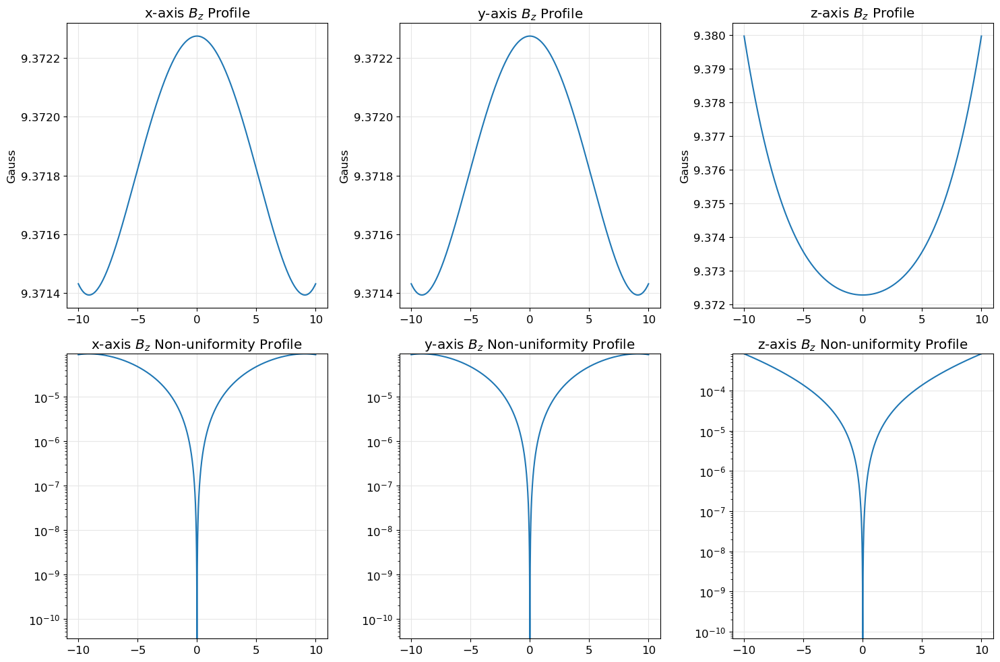

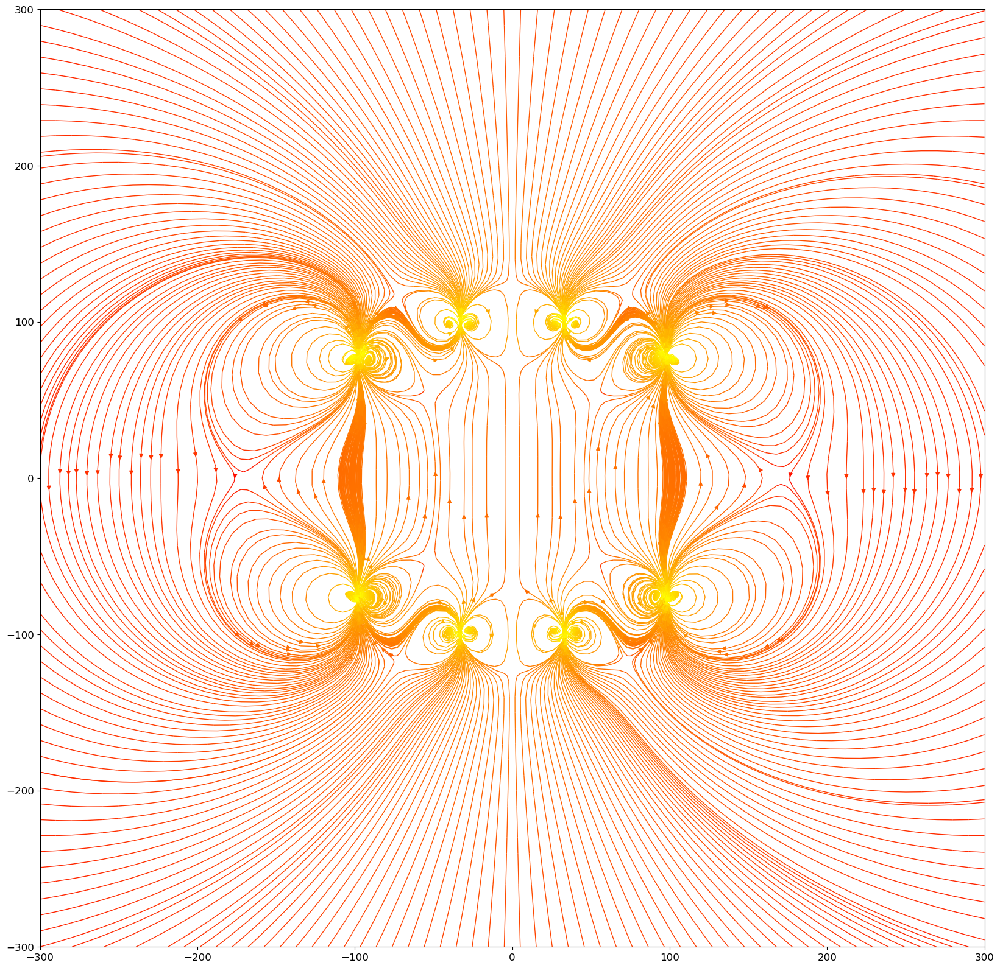

In [11]:
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

x_bounds = [-300, 300]
z_bounds = [-300, 300]
outerrad1 = innerrad1 + width
make_flux_stream(magnets, x_bounds, z_bounds, [])

## Testing zone

FOM objective function to minimize nonuniformity and maximize central field simultaneously.

In [20]:
# define FOM as nonuniformity * 1/center_field as we want to minimize nonuniformity and maximize center field
def max_fom(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity * 1/center_field
bounds = Bounds([10, 10, 2, 2, 1, 1], [150, 150, 10, 20, 220, 250])
# c_d, c_h, D
x0 = [60, 33, 5, 2.4, 40, 80]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_fom, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.007781
         Iterations: 701
         Function evaluations: 1113
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 0.007780673897431684
             x: [ 4.492e+01  2.918e+01  1.000e+01  2.693e+00  7.165e+01
                  9.785e+01]
           nit: 701
          nfev: 1113
 final_simplex: (array([[ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       ...,
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01]]), array([ 7.781e-03,  7.781e-03,  7.781e-03,  7.781e-03,
                        7.781e-03,  7.781e-03,  7.781e-03]))


In [22]:
method = "Powell"
res = minimize(max_fom, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000806
         Iterations: 10
         Function evaluations: 1706
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 0.000806052841564818
       x: [ 8.179e+01  6.294e+01  5.000e+00  1.999e+01  1.315e+02
            2.065e+02]
     nit: 10
   direc: [[-6.475e-02 -8.438e-02 ...  5.263e-02 -2.816e-04]
           [ 0.000e+00  1.000e+00 ...  0.000e+00  0.000e+00]
           ...
           [ 0.000e+00  0.000e+00 ...  1.000e+00  0.000e+00]
           [-6.791e-05 -3.854e-04 ... -2.789e-07 -1.880e-06]]
    nfev: 1706


In [24]:
# define FOM as nonuniformity * 1/center_field as we want to minimize nonuniformity and maximize center field
def max_fom(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_rings(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity * 1/center_field
bounds = Bounds([10, 10, 2, 2, 1, 1], [150, 150, 10, 20, 110, 110])
# c_d, c_h, D
x0 = [60, 33, 5, 2.4, 40, 80]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_fom, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.007781
         Iterations: 701
         Function evaluations: 1113
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 0.007780673897431684
             x: [ 4.492e+01  2.918e+01  1.000e+01  2.693e+00  7.165e+01
                  9.785e+01]
           nit: 701
          nfev: 1113
 final_simplex: (array([[ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       ...,
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01]]), array([ 7.781e-03,  7.781e-03,  7.781e-03,  7.781e-03,
                        7.781e-03,  7.781e-03,  7.781e-03]))
